In [1]:
from load import StableDiffusionDetectionDataset
import torch
from torch import nn
from torch.utils.data import DataLoader, random_split
import torch.nn.functional as F
from torchvision import transforms
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from util import tfft, tabs, tlog, tnorm, spec
from torchvision import models

In [2]:
batch_size = 16
spectrogram = False

In [3]:
transform = transforms.Compose([transforms.ToTensor(), transforms.Resize((299, 299)), transforms.RandomHorizontalFlip()])

if spectrogram:
    transform = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Resize((299, 299)),
            transforms.Lambda(spec),
        ]
    )

dataset = StableDiffusionDetectionDataset('data/stable_diffusion_detection.csv', 'data', transform=transform, samples=1000)

train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size

train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=10)

test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=10)

print(len(dataset))

2000


In [4]:
print(dataset[0])

(tensor([[[0.3221, 0.3287, 0.3138,  ..., 0.5664, 0.5657, 0.5602],
         [0.3192, 0.3286, 0.3160,  ..., 0.5658, 0.5560, 0.5541],
         [0.3246, 0.3213, 0.3115,  ..., 0.5204, 0.5079, 0.5042],
         ...,
         [0.4510, 0.4470, 0.4469,  ..., 0.4684, 0.4855, 0.4772],
         [0.4473, 0.4434, 0.4462,  ..., 0.4684, 0.4821, 0.4794],
         [0.4510, 0.4639, 0.4706,  ..., 0.4723, 0.4794, 0.4697]],

        [[0.0397, 0.0375, 0.0348,  ..., 0.4294, 0.4169, 0.3987],
         [0.0442, 0.0392, 0.0335,  ..., 0.4246, 0.4167, 0.3902],
         [0.0423, 0.0389, 0.0336,  ..., 0.3368, 0.3174, 0.3124],
         ...,
         [0.3529, 0.3604, 0.3676,  ..., 0.3874, 0.3807, 0.3812],
         [0.3566, 0.3603, 0.3545,  ..., 0.3845, 0.3773, 0.3855],
         [0.3686, 0.3687, 0.3767,  ..., 0.3911, 0.3872, 0.3840]],

        [[0.0487, 0.0532, 0.0454,  ..., 0.4933, 0.4771, 0.4630],
         [0.0371, 0.0431, 0.0431,  ..., 0.4798, 0.4723, 0.4609],
         [0.0462, 0.0429, 0.0375,  ..., 0.3878, 0.3747, 0

data[0].shape torch.Size([16, 3, 299, 299])
data[1].shape torch.Size([16, 1])
tensor([[0],
        [1],
        [0],
        [1],
        [0],
        [1],
        [0],
        [1],
        [0],
        [1],
        [0],
        [1],
        [0],
        [0],
        [1],
        [1]])


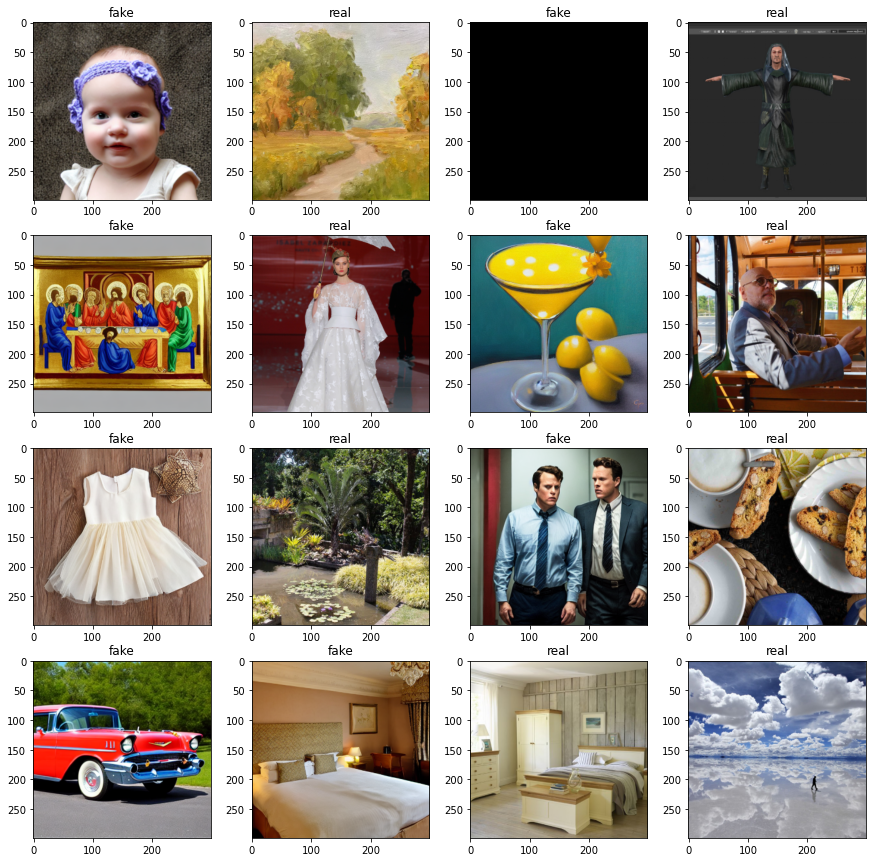

In [5]:
labels = ['fake', 'real']

for i, data in enumerate(iter(test_loader)):
    print('data[0].shape', data[0].shape)
    print('data[1].shape', data[1].shape)

    print(data[1])

    # Grid of 16 images, 4 rows x 4 columns
    fig, axs = plt.subplots(4, 4, figsize=(15, 15))

    for j in range(16):
        # Get the image and label
        img = data[0][j]
        label = data[1][j][0]

        # Insert the image into the grid
        if spectrogram:
            axs[j // 4, j % 4].imshow((img.permute(1, 2, 0) + 1) / 2, interpolation='none', cmap='jet')
        else:
            axs[j // 4, j % 4].imshow(img.permute(1, 2, 0))
        axs[j // 4, j % 4].set_title(labels[label.item()])


    break


In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if not torch.backends.mps.is_available():
    if not torch.backends.mps.is_built():
        print("MPS not available because the current PyTorch install was not "
              "built with MPS enabled.")
    else:
        print("MPS not available because the current MacOS version is not 12.3+ "
              "and/or you do not have an MPS-enabled device on this machine.")

else:
    device = torch.device("mps")


class VisionBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride = 1, padding = 0):
        super(VisionBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels - in_channels, kernel_size, stride, padding)
        self.bn1 = nn.BatchNorm2d(out_channels - in_channels)

        self.conv2 = nn.Conv2d(out_channels - in_channels, out_channels - in_channels, kernel_size, stride, padding)
        self.bn2 = nn.BatchNorm2d(out_channels - in_channels)


    def forward(self, img):
        img_ = self.conv1(img)
        img_ = self.bn1(img_)
        img_ = F.relu(img_)
        img_ = self.conv2(img_)
        img_ = self.bn2(img_)
        img_ = F.relu(img_)

        return torch.cat((img, img_), 1)

class Model(nn.Module):
    def __init__(self):
        super(Model, self).__init__()

        self.conv1 = VisionBlock(3, 16, 5, padding=2)
        self.pool1 = nn.MaxPool2d(2, 2)

        self.conv2 = VisionBlock(16, 32, 5, padding=2)
        self.pool2 = nn.MaxPool2d(2, 2)

        self.conv3 = VisionBlock(32, 64, 5, padding=2)
        self.pool3 = nn.MaxPool2d(2, 2)

        self.conv4 = VisionBlock(64, 128, 5, padding=2)
        self.pool4 = nn.MaxPool2d(2, 2)

        self.conv5 = VisionBlock(128, 256, 3, padding=1)
        self.pool5 = nn.MaxPool2d(2, 2)

        self.fc1 = nn.Linear(256 * 8 * 8, 128)
        self.fc2 = nn.Linear(128, 124)
        self.fc3 = nn.Linear(124, 1)


    def forward(self, x):
        x = self.pool1(self.conv1(x))
        x = self.pool2(self.conv2(x))
        x = self.pool3(self.conv3(x))
        x = self.pool4(self.conv4(x))
        x = self.pool5(self.conv5(x))

        x = x.view(-1, 256 * 8 * 8)
        x = F.relu(self.fc1(x))

        x = F.relu(self.fc2(x))
        x = torch.sigmoid(self.fc3(x))

        return x

# model = Model()

model = models.inception_v3()

#for param in model.parameters():
#    param.requires_grad = False

model.AuxLogits.fc = nn.Linear(768, 1)
model.fc = nn.Linear(2048, 1)

model.to(device)

/opt/homebrew/Caskroom/miniforge/base/envs/sdd/lib/python3.10/site-packages/torchvision/models/inception.py:43: FutureWarning: The default weight initialization of inception_v3 will be changed in future releases of torchvision. If you wish to keep the old behavior (which leads to long initialization times due to scipy/scipy#11299), please set init_weights=True.
  warnings.warn(


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [7]:
learning_rates = [1e-4, 1e-5, 1e-6, 1e-7]
momentum = 0.9
epochs = 3
criterion = nn.BCELoss()

# Learning rate scheduler
# scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

In [8]:
## compute accuracy single output
def get_accuracy(logit, target, batch_size):
    ''' Obtain accuracy for training round '''
    corrects = (torch.round(logit).view(-1) == target.view(-1)).sum()
    accuracy = 100.0 * corrects/batch_size
    return accuracy

In [9]:
for learning_rate in learning_rates:
  print('learning_rate', learning_rate)
  model = models.inception_v3()

  #for param in model.parameters():
  #    param.requires_grad = False

  model.AuxLogits.fc = nn.Linear(768, 1)
  model.fc = nn.Linear(2048, 1)

  model.to(device)

  optimizer = torch.optim.RMSprop(model.parameters(), lr=learning_rate)
  for epoch in range(epochs):
    #Put the model in training mode
    model = model.train()

    train_running_loss = 0.0
    train_acc = 0.0
    for idx, (images, labels) in enumerate(train_loader):
      images = images.to(device)
      labels = labels.to(torch.float32).to(device)

      ## forward + backprop + loss
      output, aux_output = model(images)

      loss1 = criterion(output, labels)
      loss2 = criterion(aux_output, labels)
      loss = loss1 + 0.4*loss2
      optimizer.zero_grad()
      loss.backward()

      ## update model params
      optimizer.step()
      # scheduler.step()
      
      train_running_loss += loss.detach().item()
      train_acc += get_accuracy(output, labels, labels.shape[0])

    print('Epoch: %d | Loss: %.4f | Train Accuracy: %.2f' \
            %(epoch, train_running_loss / idx, train_acc / idx))

    

    model = model.eval()
    test_acc = 0.0
    for i, (images, labels) in enumerate(test_loader):
        images = images.to(device)
        labels = labels.to(device)
        output = model(images)
        test_acc += get_accuracy(output, labels, labels.shape[0])

    print(f"Test Accuracy: {test_acc/i}, in epoch: {epoch}")


learning_rate 1e-08
Epoch: 0 | Loss: 138.0734 | Train Accuracy: 0.44
Test Accuracy: 0.0, in epoch: 0
Epoch: 1 | Loss: 141.4141 | Train Accuracy: 0.00
Test Accuracy: 0.0, in epoch: 1
Epoch: 2 | Loss: 141.4141 | Train Accuracy: 0.00
Test Accuracy: 0.0, in epoch: 2


In [10]:
# model = model.eval()
# test_acc = 0.0
# for i, (images, labels) in enumerate(test_loader):
#     images = images.to(device)
#     labels = labels.to(device)
#     outputs = model(images)
#     test_acc += get_accuracy(outputs, labels, batch_size)

# print(f"Test Accuracy: {test_acc/i}, in epoch: {epoch}")

/var/folders/mk/7wnwqr192b79qr8pf4k24k300000gn/T/ipykernel_48337/1988546174.py:10: UserWarning: The operator 'aten::nonzero' is not currently supported on the MPS backend and will fall back to run on the CPU. This may have performance implications. (Triggered internally at  /Users/runner/miniforge3/conda-bld/pytorch-recipe_1660136240338/work/aten/src/ATen/mps/MPSFallback.mm:11.)
  indices = (((torch.round(outputs).view(-1) == labels.view(-1)) == False).nonzero().view(-1))


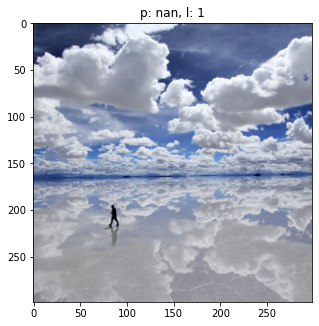

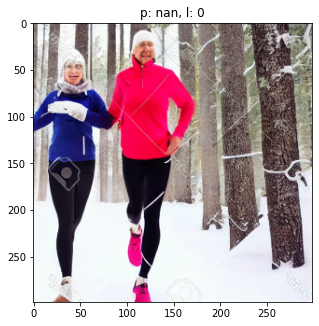

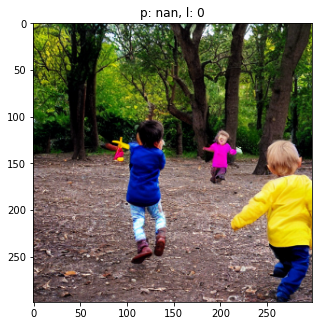

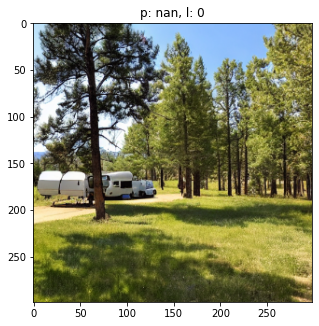

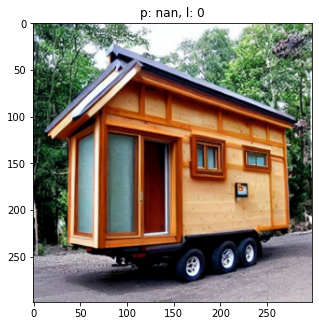

...

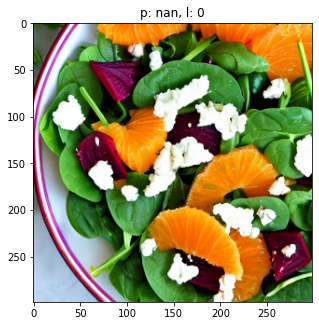

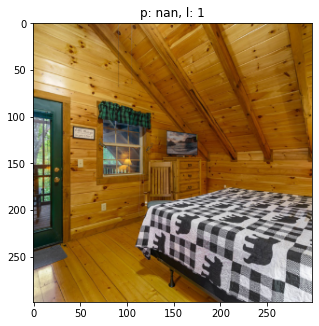

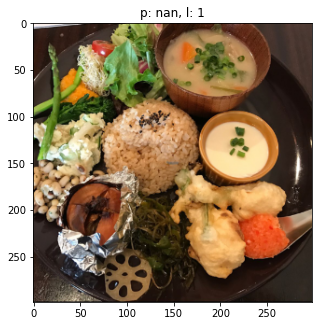

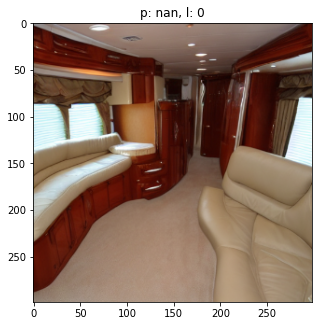

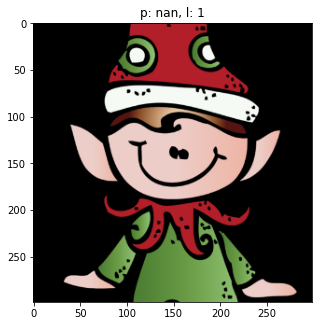

In [11]:
for i, (images, labels) in enumerate(test_loader):
    images = images.to(device)
    labels = labels.to(device)
    outputs = model(images)


    bad_images = []
    bad_preds = []
    bad_labels = []
    indices = (((torch.round(outputs).view(-1) == labels.view(-1)) == False).nonzero().view(-1))
    for index in indices:
        bad_images.append(images[index])
        bad_preds.append(outputs[index])
        bad_labels.append(labels[index])

    if len(bad_images) <= 0:
        continue

    for j in range(len(bad_images)):
        fig, ax = plt.subplots(figsize=(5, 10))
        if spectrogram:
            ax.imshow((bad_images[j].cpu().permute(1, 2, 0) + 1) / 2)
        else:
            ax.imshow(bad_images[j].cpu().permute(1, 2, 0))
        ax.set_title(f"p: {bad_preds[j].item()}, l: {bad_labels[j].item()}")
        plt.show()
    
    if i == 10:
        break
